# Linear Regression 1D

In [1]:

from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future


import numpy as np
import matplotlib.pyplot as plt
import pandas as pd


In [2]:
columns = ['x','y']
df = pd.read_csv('data_1d.csv',header=None,names=columns)
df.head()

,x,y
0,80.407232,161.883812
1,30.801499,67.761372
2,26.730291,61.207997
3,40.616047,76.438155
4,18.438316,43.088636


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       100 non-null    float64
 1   y       100 non-null    float64
dtypes: float64(2)
memory usage: 1.7 KB


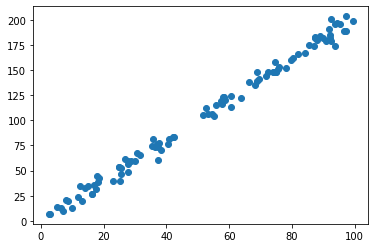

In [4]:
plt.scatter(df.x,df.y)
plt.show()

### here A and B need to switch
<img src="./images/formula_01.png">
<img src="./images/formula_02.png">
<img src="./images/dot.png">

In [5]:
# devide by n
denominator = df.x.dot(df.x) - df.x.mean()*df.x.sum()
b = (df.y.mean()*df.x.dot(df.x) - df.x.mean()*df.y.dot(df.x))/denominator
a = (df.x.dot(df.y) - df.x.mean()*df.y.sum())/denominator

In [6]:
# denominator = df.x.dot(df.x) - df.x.mean() * df.x.sum()
# a = ( df.x.dot(Y) - df.y.mean()*df.x.sum() ) / denominator
# b = ( df.y.mean() * df.x.dot(df.x) - df.x.mean() * df.x.dot(df.y) ) / denominator

In [7]:
# let's calculate the predicted Y
Yhat = a*df.x + b*df.y

In [8]:
# df.sort_values('x')

In [9]:
# np.sort(Yhat)

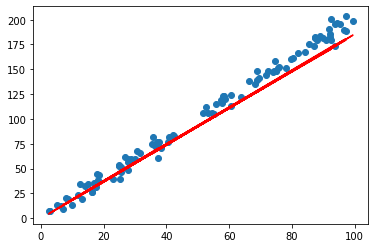

In [10]:
plt.scatter(df.x,df.y)
plt.plot(df.x,Yhat,color='r')
plt.show()

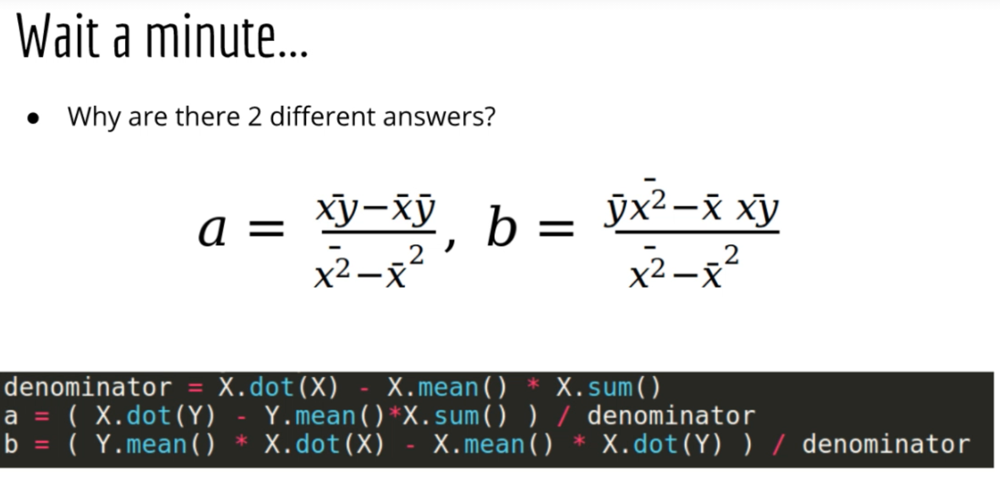

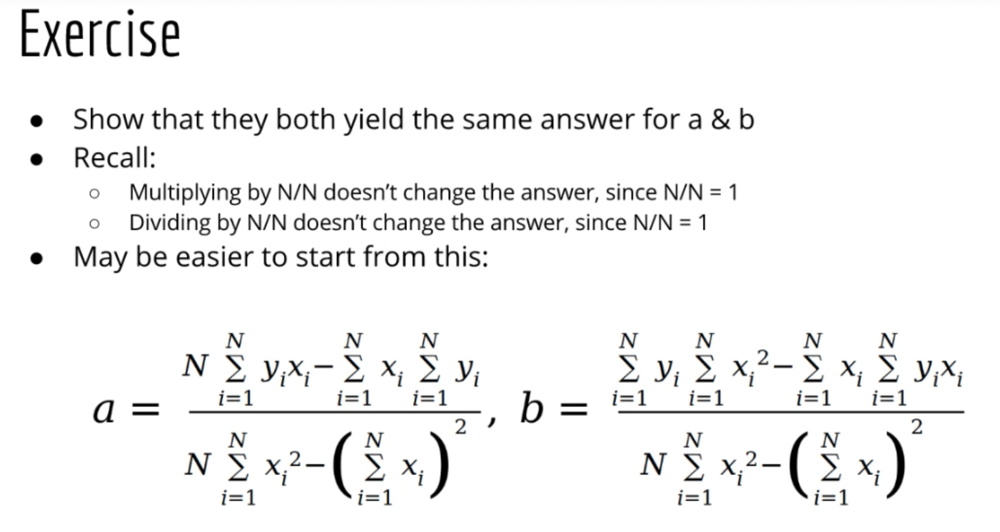

### R-squared

In [11]:
# determine how good the model is by computing the r-squared
d1 = df.y - Yhat
d2 = df.y - df.y.mean()
r2 = 1 - d1.dot(d1) / d2.dot(d2)
print("the r-squared is:", r2)

the r-squared is: 0.9639334496609109


## Moor's low problem

In [12]:
#take the log of the value

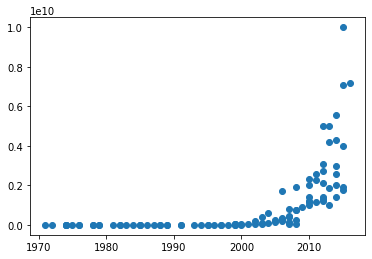

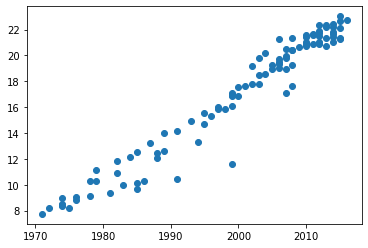

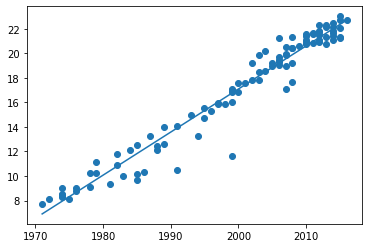

a: 0.3510435733650199 b: -685.000284381709
the r-squared is: 0.952944285228576
time to double: 1.9745331723797188 years


In [13]:
from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future


import re
import numpy as np
import matplotlib.pyplot as plt

X = []
Y = []

# some numbers show up as 1,170,000,000 (commas)
# some numbers have references in square brackets after them
non_decimal = re.compile(r'[^\d]+')

for line in open('moore.csv'):
    r = line.split('\t')

    x = int(non_decimal.sub('', r[2].split('[')[0]))
    y = int(non_decimal.sub('', r[1].split('[')[0]))
    X.append(x)
    Y.append(y)


X = np.array(X)
Y = np.array(Y)

plt.scatter(X, Y)
plt.show()

Y = np.log(Y)
plt.scatter(X, Y)
plt.show()

# copied from lr_1d.py
denominator = X.dot(X) - X.mean() * X.sum()
a = ( X.dot(Y) - Y.mean()*X.sum() ) / denominator
b = ( Y.mean() * X.dot(X) - X.mean() * X.dot(Y) ) / denominator

# let's calculate the predicted Y
Yhat = a*X + b

plt.scatter(X, Y)
plt.plot(X, Yhat)
plt.show()

# determine how good the model is by computing the r-squared
d1 = Y - Yhat
d2 = Y - Y.mean()
r2 = 1 - d1.dot(d1) / d2.dot(d2)
print("a:", a, "b:", b)
print("the r-squared is:", r2)

# how long does it take to double?
# log(transistorcount) = a*year + b
# transistorcount = exp(b) * exp(a*year)
# 2*transistorcount = 2 * exp(b) * exp(a*year) = exp(ln(2)) * exp(b) * exp(a * year) = exp(b) * exp(a * year + ln(2))
# a*year2 = a*year1 + ln2
# year2 = year1 + ln2/a
print("time to double:", np.log(2)/a, "years")

# Multi dementional regression

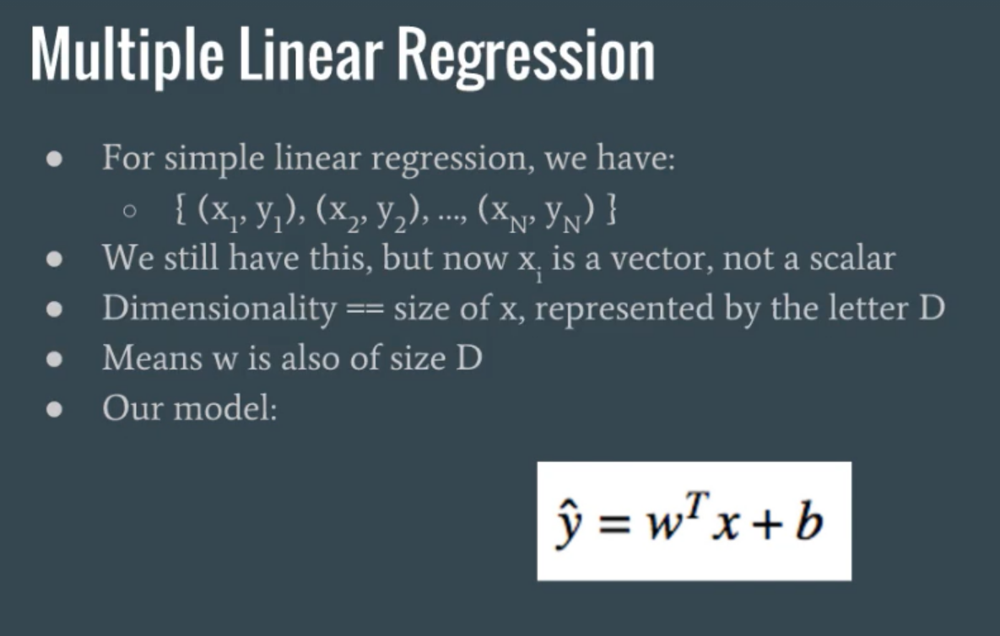

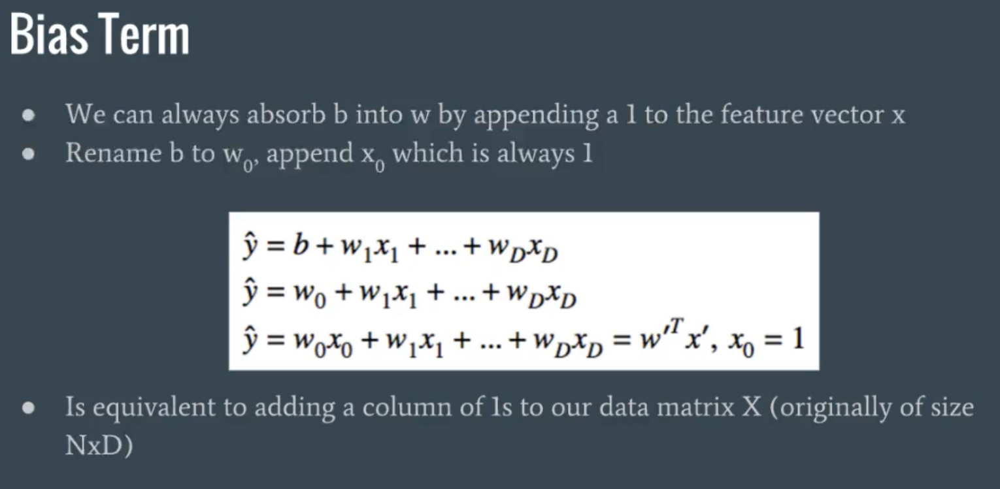

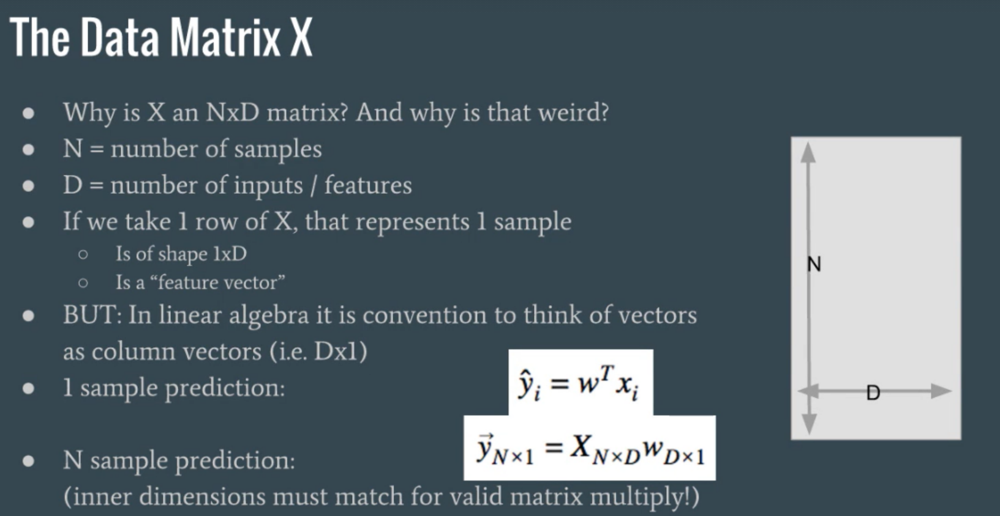

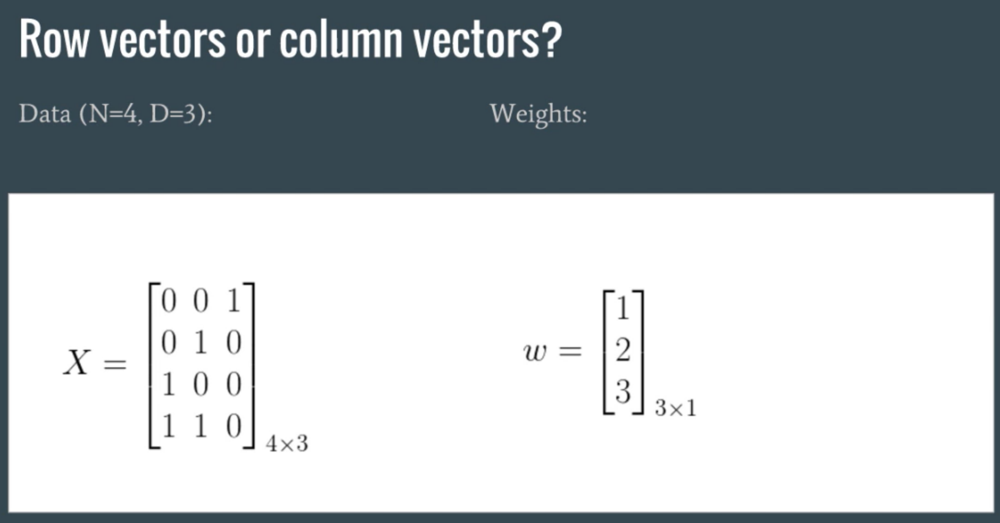

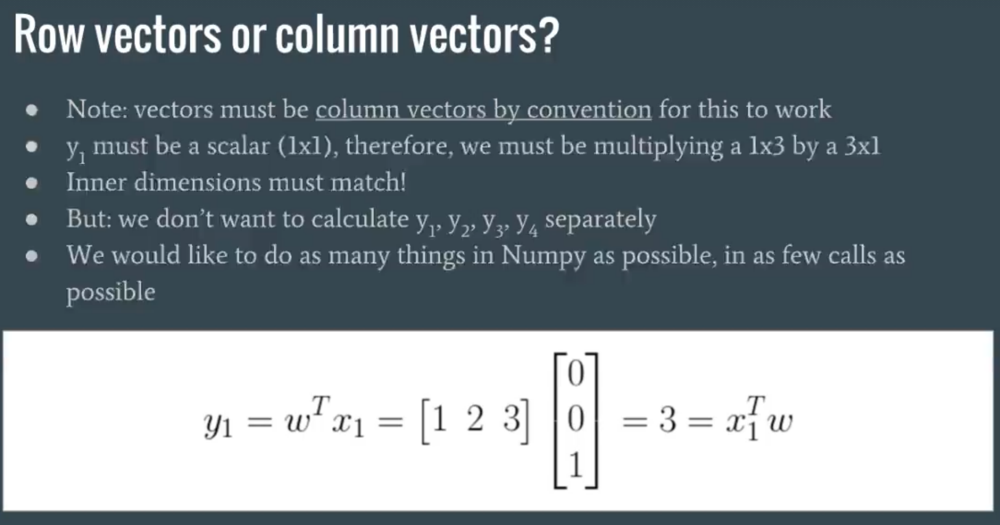

...

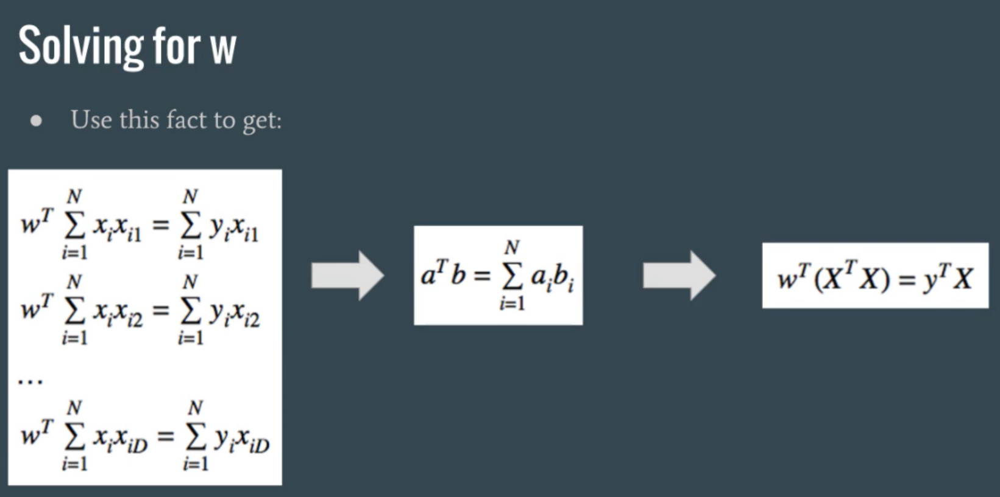

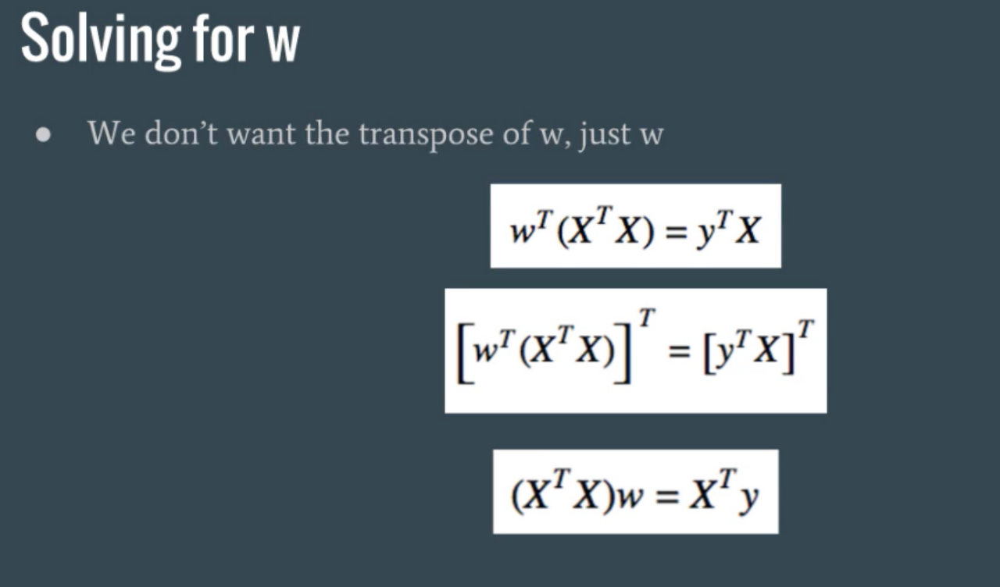

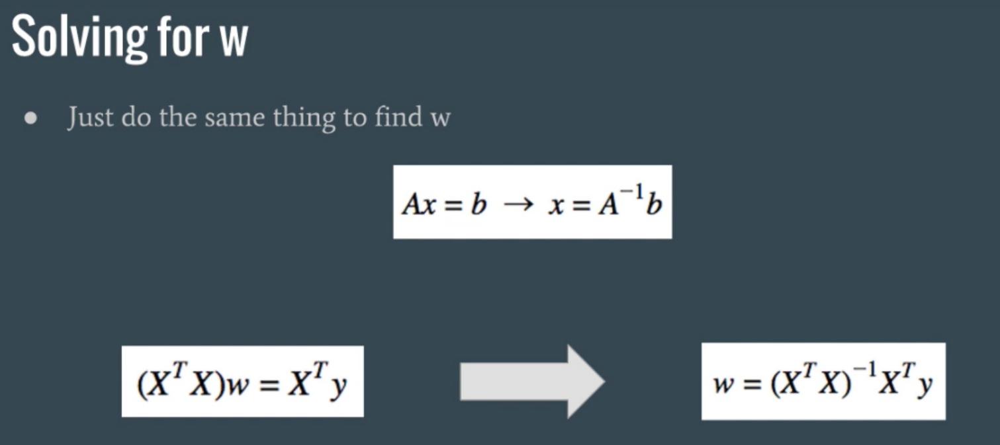

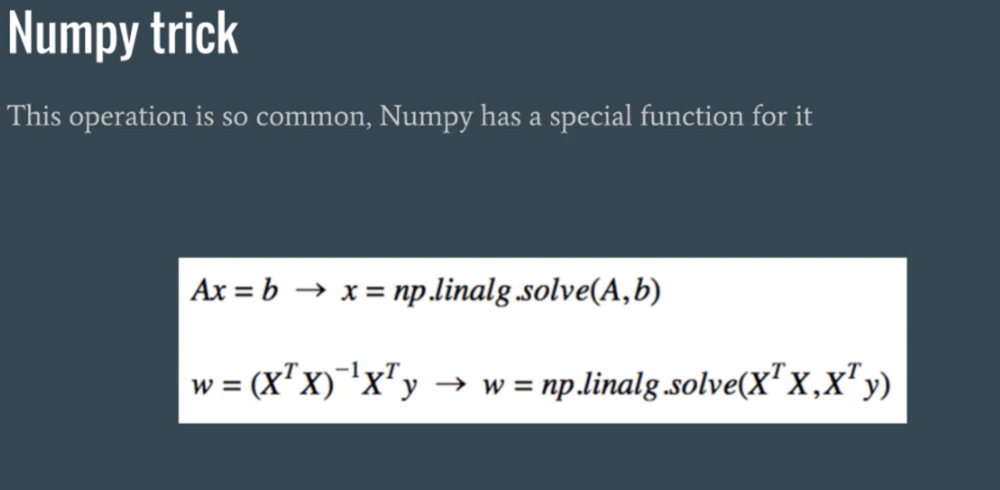

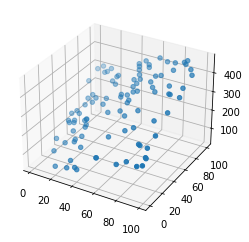

the r-squared is: 0.9980040612475777


In [14]:

from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future


import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt


# load the data
X = []
Y = []
for line in open('data_2d.csv'):
    x1, x2, y = line.split(',')
    X.append([float(x1), float(x2), 1]) # add the bias term
    Y.append(float(y))

# let's turn X and Y into numpy arrays since that will be useful later
X = np.array(X)
Y = np.array(Y)


# let's plot the data to see what it looks like
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X[:,0], X[:,1], Y)
plt.show()


# apply the equations we learned to calculate a and b
# numpy has a special method for solving Ax = b
# so we don't use x = inv(A)*b
# note: the * operator does element-by-element multiplication in numpy
#       np.dot() does what we expect for matrix multiplication
w = np.linalg.solve(np.dot(X.T, X), np.dot(X.T, Y))
Yhat = np.dot(X, w)


# determine how good the model is by computing the r-squared
d1 = Y - Yhat
d2 = Y - Y.mean()
r2 = 1 - d1.dot(d1) / d2.dot(d2)
print("the r-squared is:", r2)

## polynomal linear regression

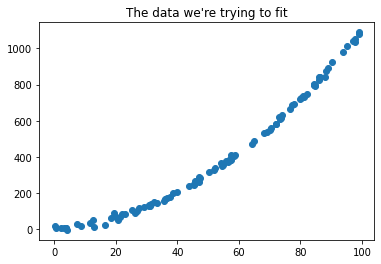

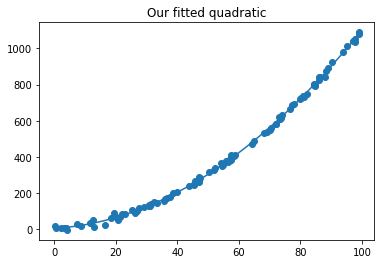

the r-squared is: 0.9991412296366858


In [15]:
from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future

import numpy as np
import matplotlib.pyplot as plt


# load the data
X = []
Y = []
for line in open('data_poly.csv'):
    x, y = line.split(',')
    x = float(x)
    X.append([1, x, x*x]) # add the bias term x0 = 1
    # our model is therefore y_hat = w0 + w1 * x + w2 * x**2
    Y.append(float(y))

# let's turn X and Y into numpy arrays since that will be useful later
X = np.array(X)
Y = np.array(Y)

# let's plot the data to see what it looks like
plt.scatter(X[:,1], Y)
plt.title("The data we're trying to fit")
plt.show()


# apply the equations we learned to calculate a and b
# numpy has a special method for solving Ax = b
# so we don't use x = inv(A)*b
# note: the * operator does element-by-element multiplication in numpy
#       np.dot() does what we expect for matrix multiplication
w = np.linalg.solve(np.dot(X.T, X), np.dot(X.T, Y))


# let's plot everything together to make sure it worked
plt.scatter(X[:,1], Y)

# to plot our quadratic model predictions, let's
# create a line of x's and calculate the predicted y's
x_line = np.linspace(X[:,1].min(), X[:,1].max())
y_line = w[0] + w[1] * x_line + w[2] * x_line * x_line
plt.plot(x_line, y_line)
plt.title("Our fitted quadratic")
plt.show()


# determine how good the model is by computing the r-squared
Yhat = X.dot(w)
d1 = Y - Yhat
d2 = Y - Y.mean()
r2 = 1 - d1.dot(d1) / d2.dot(d2)
print("the r-squared is:", r2)

# predicting systolic blood pressure

In [16]:

# The data (X1, X2, X3) are for each patient.
# X1 = systolic blood pressure
# X2 = age in years
# X3 = weight in pounds

from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future



import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

df = pd.read_excel('mlr02.xls')
X = df.values

# using age to predict systolic blood pressure
plt.scatter(X[:,1], X[:,0])
plt.show()
# looks pretty linear!

# using weight to predict systolic blood pressure
plt.scatter(X[:,2], X[:,0])
plt.show()
# looks pretty linear!

df['ones'] = 1
Y = df['X1']
X = df[['X2', 'X3', 'ones']]
X2only = df[['X2', 'ones']]
X3only = df[['X3', 'ones']]

def get_r2(X, Y):
    w = np.linalg.solve( X.T.dot(X), X.T.dot(Y) )
    Yhat = X.dot(w)

    # determine how good the model is by computing the r-squared
    d1 = Y - Yhat
    d2 = Y - Y.mean()
    r2 = 1 - d1.dot(d1) / d2.dot(d2)
    return r2

print("r2 for x2 only:", get_r2(X2only, Y))
print("r2 for x3 only:", get_r2(X3only, Y))
print("r2 for both:", get_r2(X, Y))

ValueError: File is not a recognized excel file

# Generalization

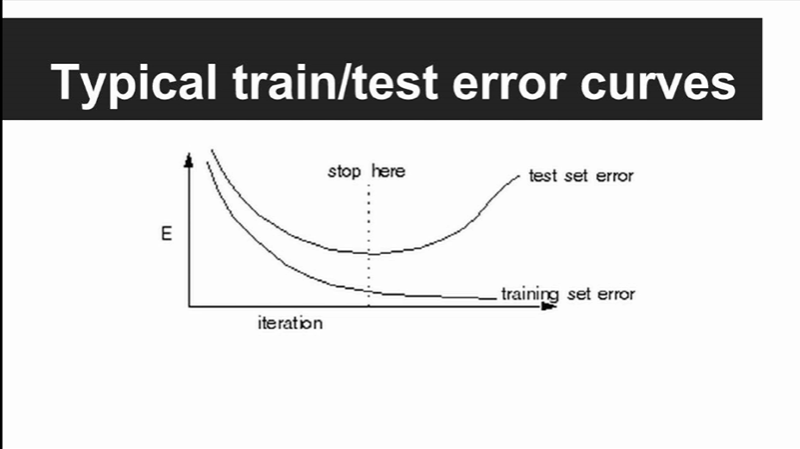

In [18]:

from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future


import numpy as np
import matplotlib.pyplot as plt


def make_poly(X, deg):
    n = len(X)
    data = [np.ones(n)]
    for d in range(deg):
        data.append(X**(d+1))
    return np.vstack(data).T


def fit(X, Y):
    return np.linalg.solve(X.T.dot(X), X.T.dot(Y))


def fit_and_display(X, Y, sample, deg):
    N = len(X)
    train_idx = np.random.choice(N, sample)
    Xtrain = X[train_idx]
    Ytrain = Y[train_idx]

    plt.scatter(Xtrain, Ytrain)
    plt.show()

    # fit polynomial
    Xtrain_poly = make_poly(Xtrain, deg)
    w = fit(Xtrain_poly, Ytrain)

    # display the polynomial
    X_poly = make_poly(X, deg)
    Y_hat = X_poly.dot(w)
    plt.plot(X, Y)
    plt.plot(X, Y_hat)
    plt.scatter(Xtrain, Ytrain)
    plt.title("deg = %d" % deg)
    plt.show()


def get_mse(Y, Yhat):
    d = Y - Yhat
    return d.dot(d) / len(d)


def plot_train_vs_test_curves(X, Y, sample=20, max_deg=20):
    N = len(X)
    train_idx = np.random.choice(N, sample)
    Xtrain = X[train_idx]
    Ytrain = Y[train_idx]

    test_idx = [idx for idx in range(N) if idx not in train_idx]
    # test_idx = np.random.choice(N, sample)
    Xtest = X[test_idx]
    Ytest = Y[test_idx]

    mse_trains = []
    mse_tests = []
    for deg in range(max_deg+1):
        Xtrain_poly = make_poly(Xtrain, deg)
        w = fit(Xtrain_poly, Ytrain)
        Yhat_train = Xtrain_poly.dot(w)
        mse_train = get_mse(Ytrain, Yhat_train)

        Xtest_poly = make_poly(Xtest, deg)
        Yhat_test = Xtest_poly.dot(w)
        mse_test = get_mse(Ytest, Yhat_test)

        mse_trains.append(mse_train)
        mse_tests.append(mse_test)

    plt.plot(mse_trains, label="train mse")
    plt.plot(mse_tests, label="test mse")
    plt.legend()
    plt.show()

    plt.plot(mse_trains, label="train mse")
    plt.legend()
    plt.show()


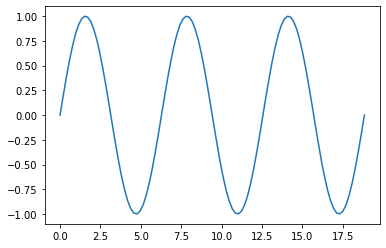

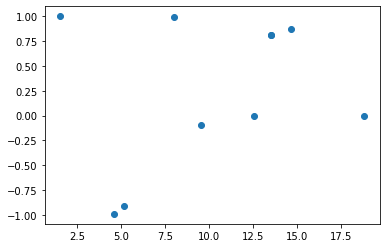

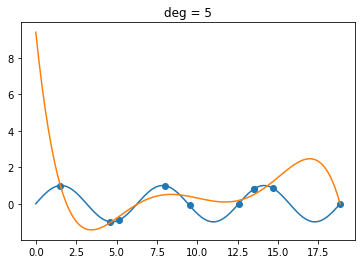

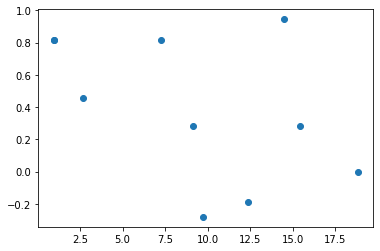

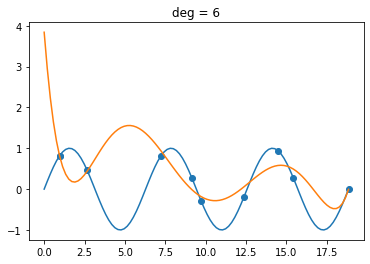

...

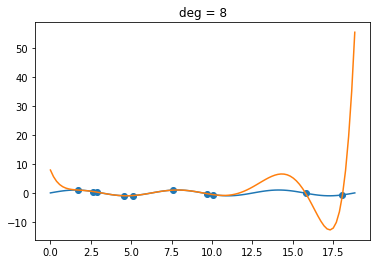

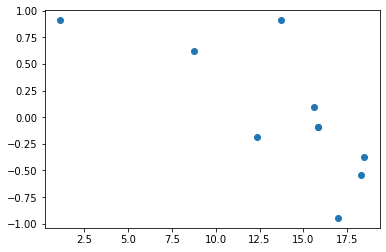

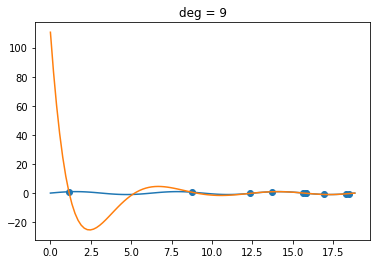

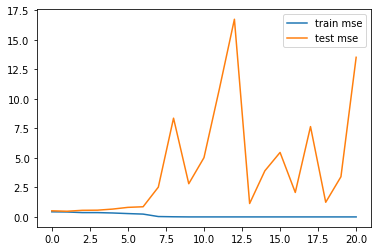

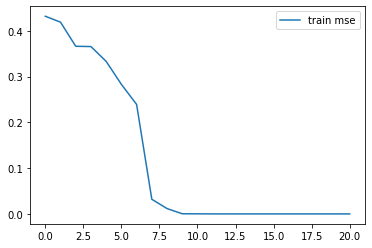

In [21]:

if __name__ == "__main__":
    # make up some data and plot it
    N = 100
    X = np.linspace(0, 6*np.pi, N)
    Y = np.sin(X)

    plt.plot(X, Y)
    plt.show()

    for deg in (5, 6, 7, 8, 9):
        fit_and_display(X, Y, 10, deg)
    plot_train_vs_test_curves(X, Y)

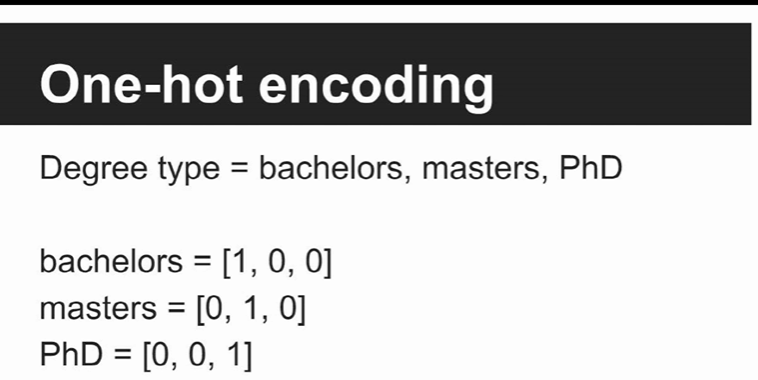

# Maximum likelihood

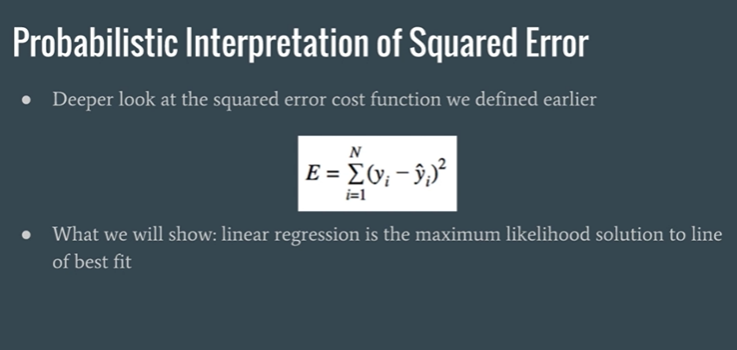

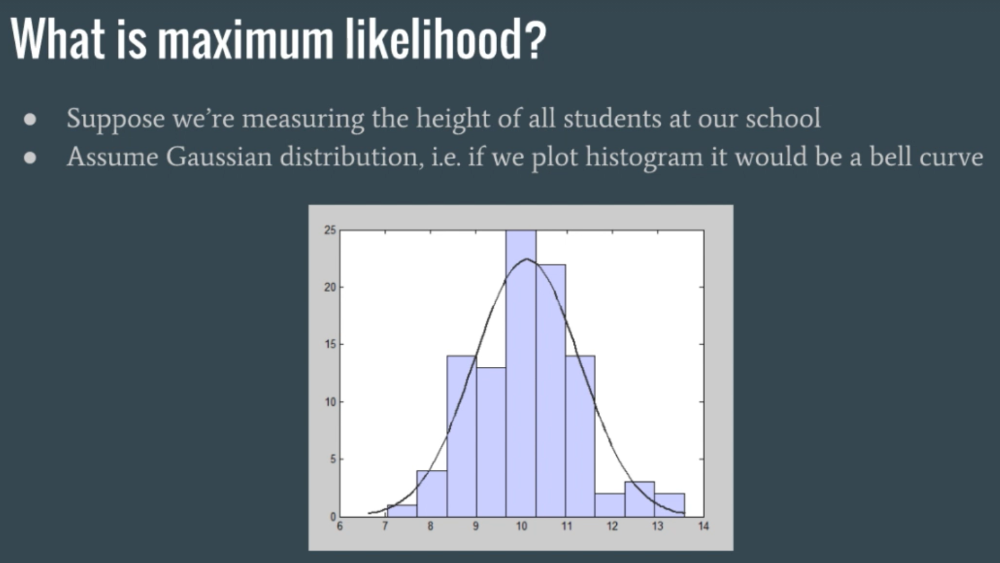

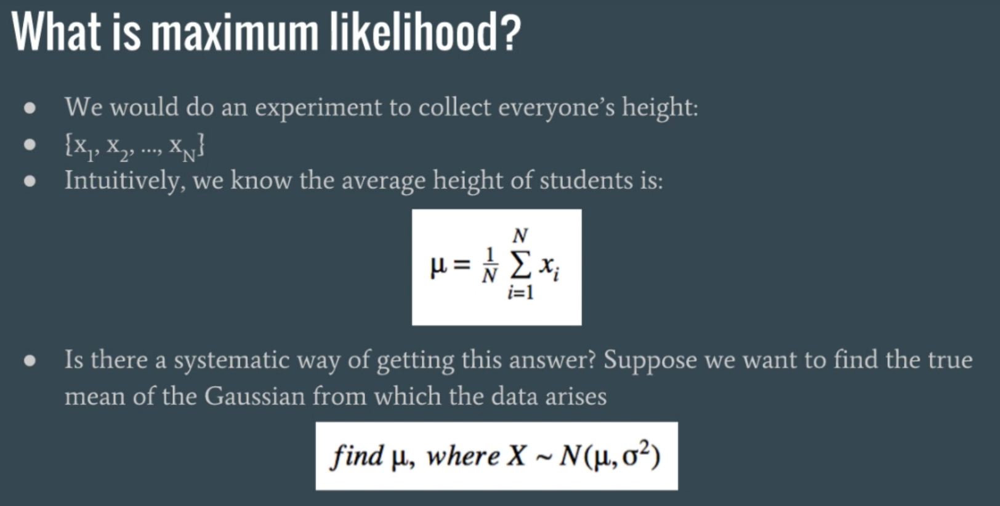

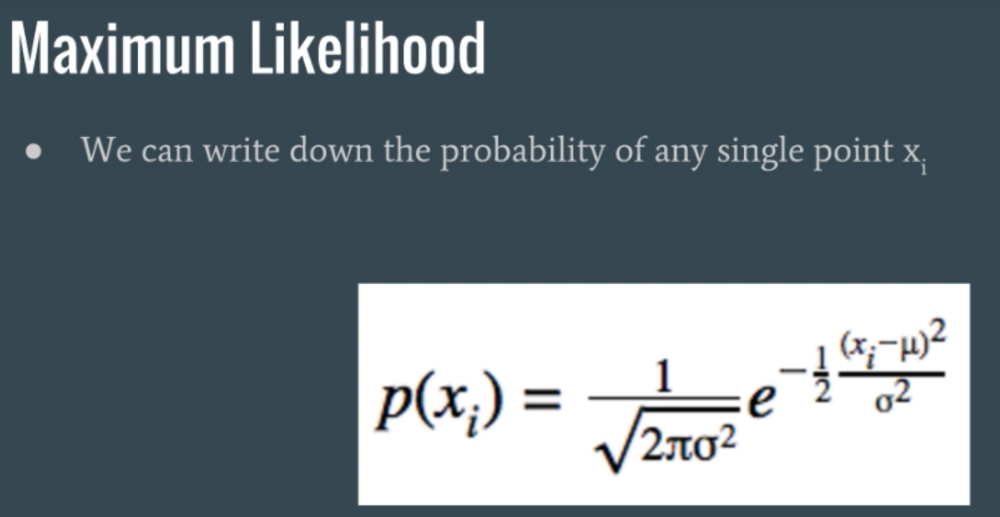

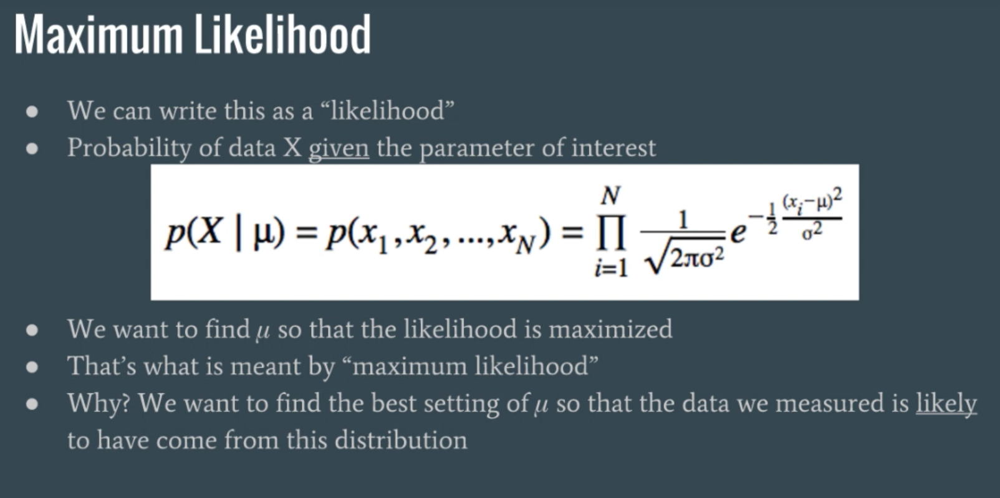

...

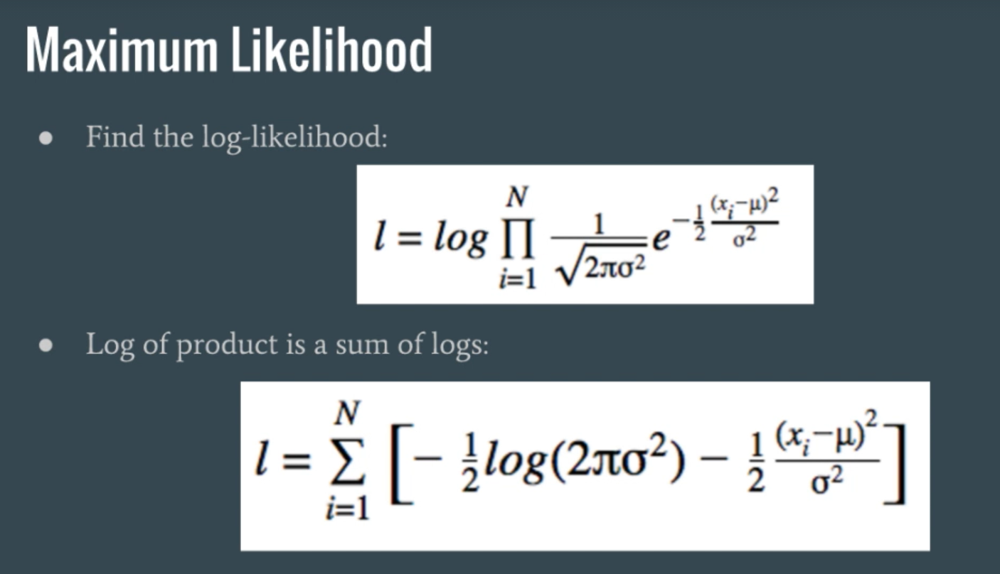

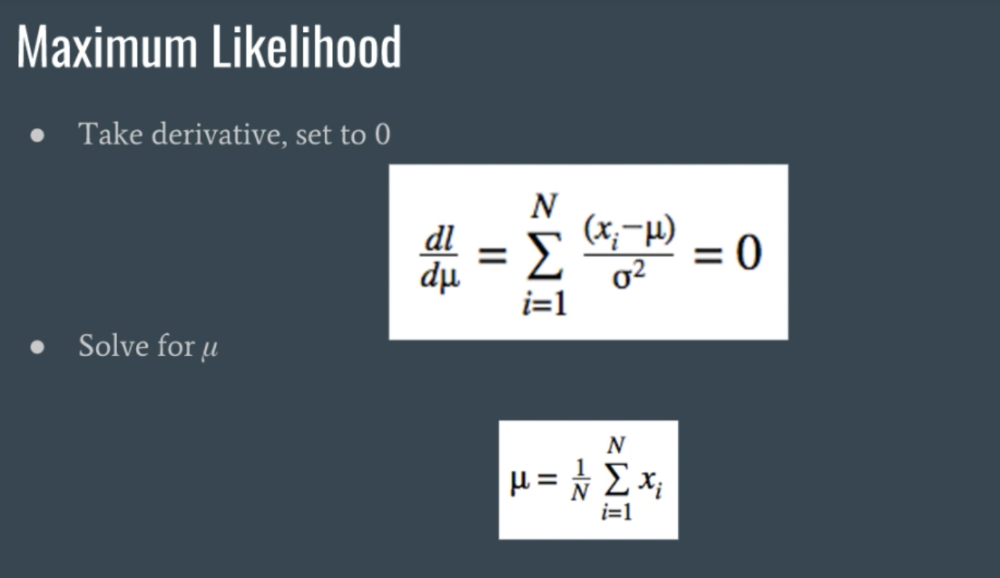

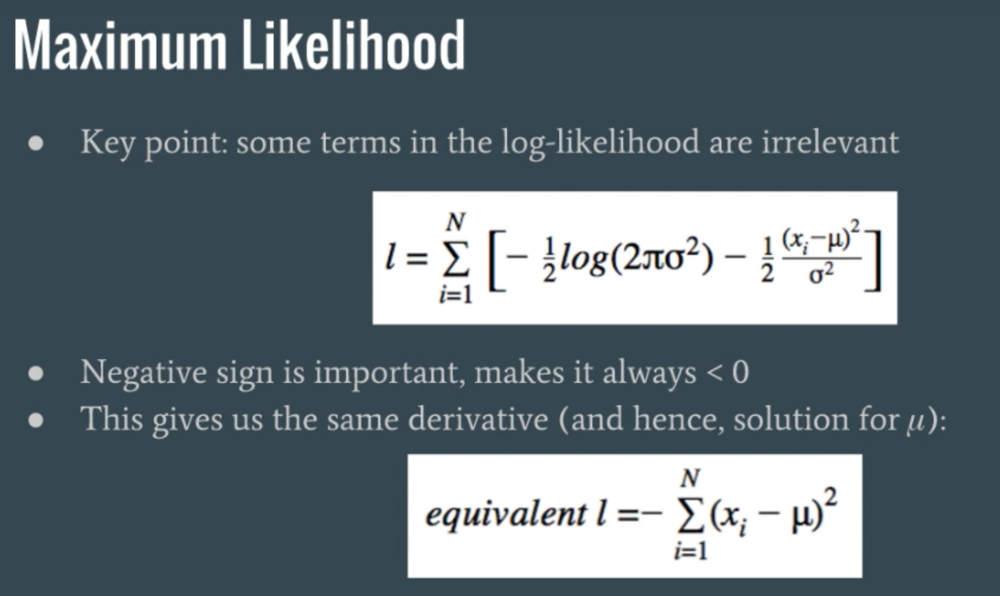

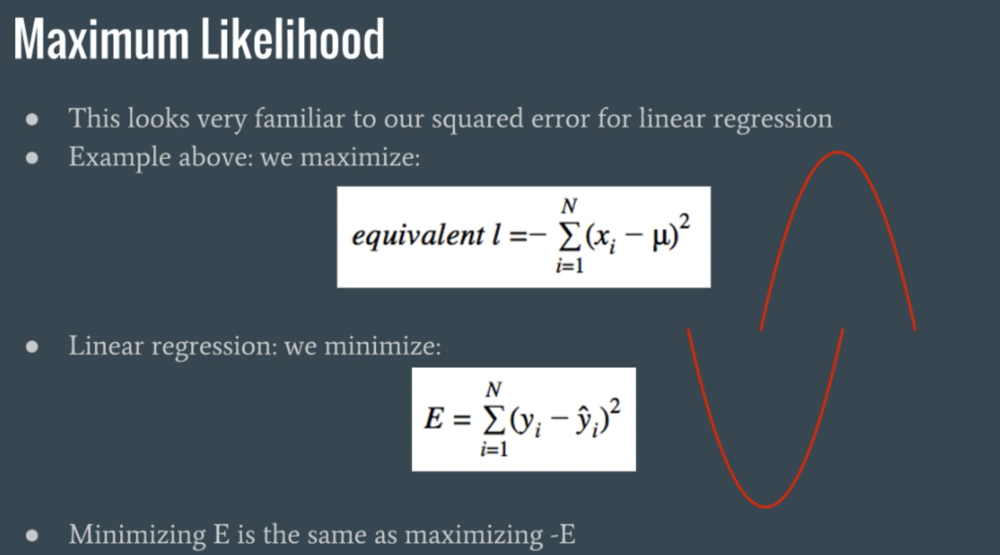

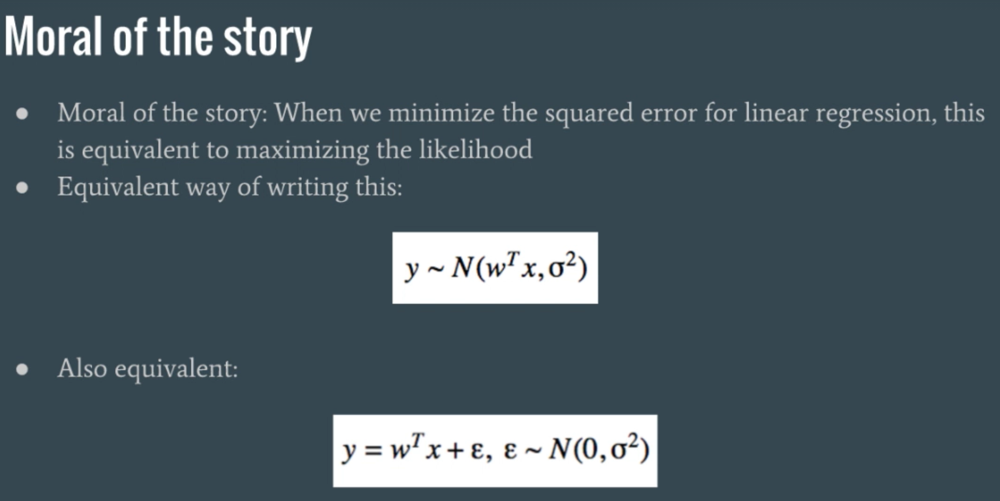

# Regularization

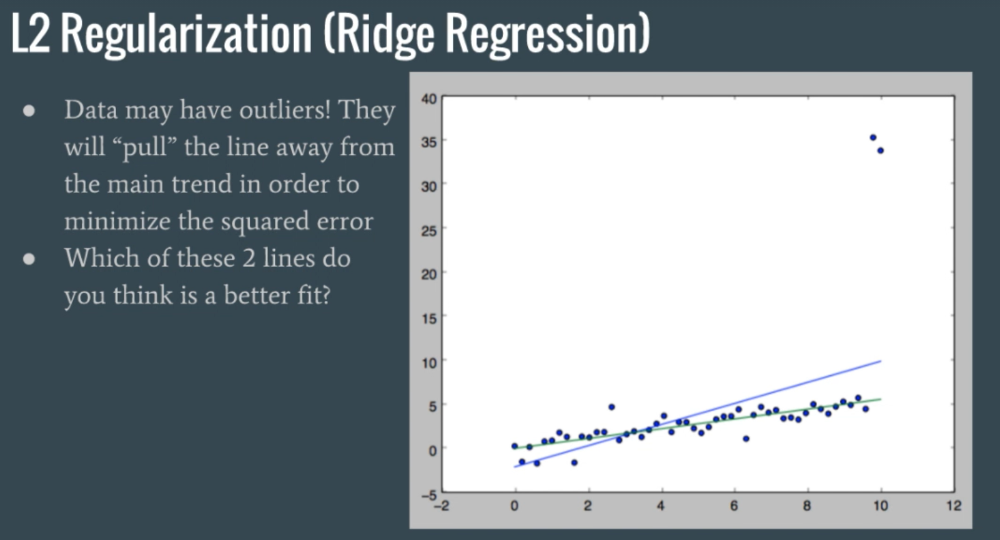

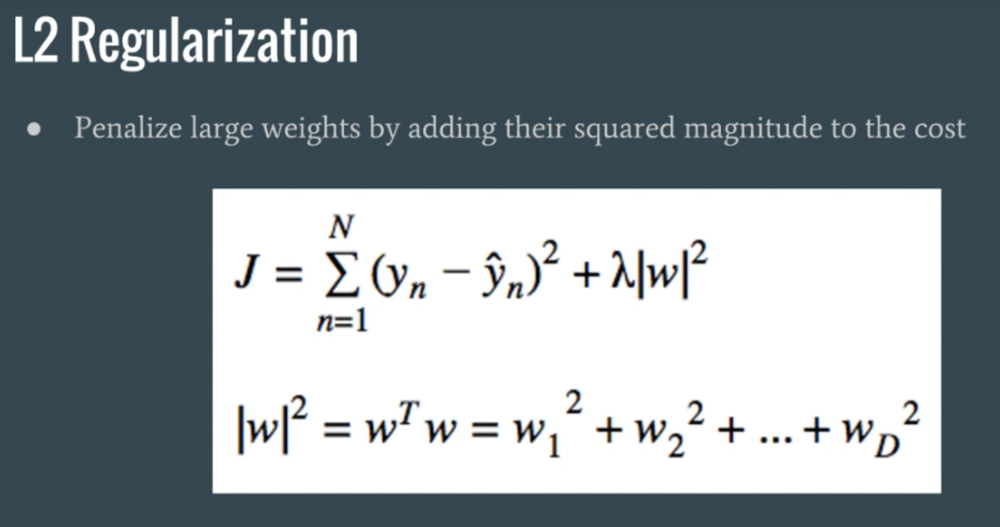

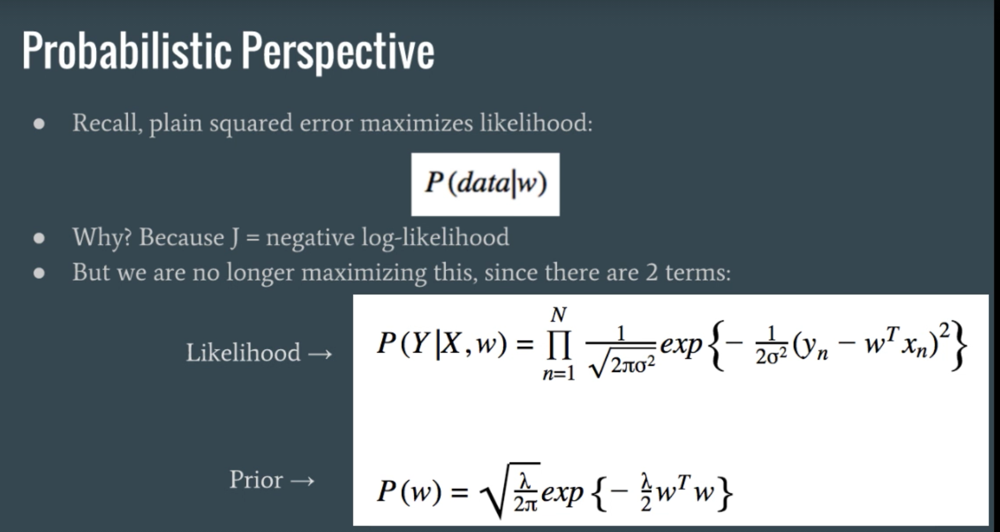

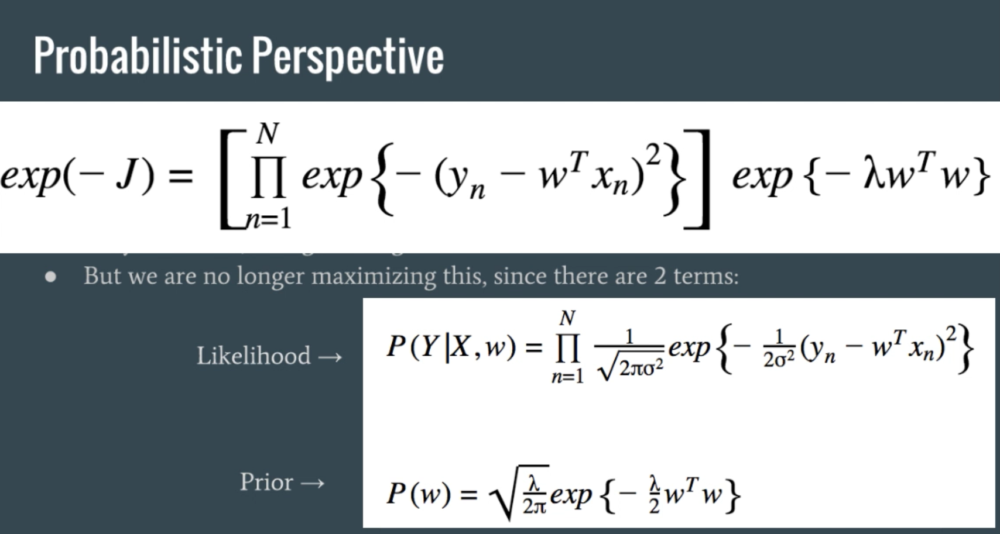

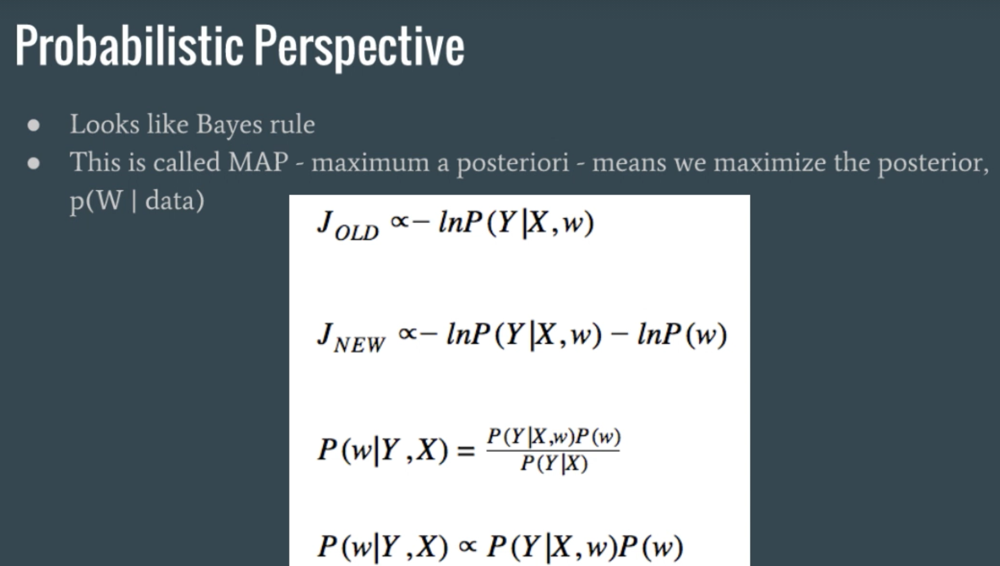

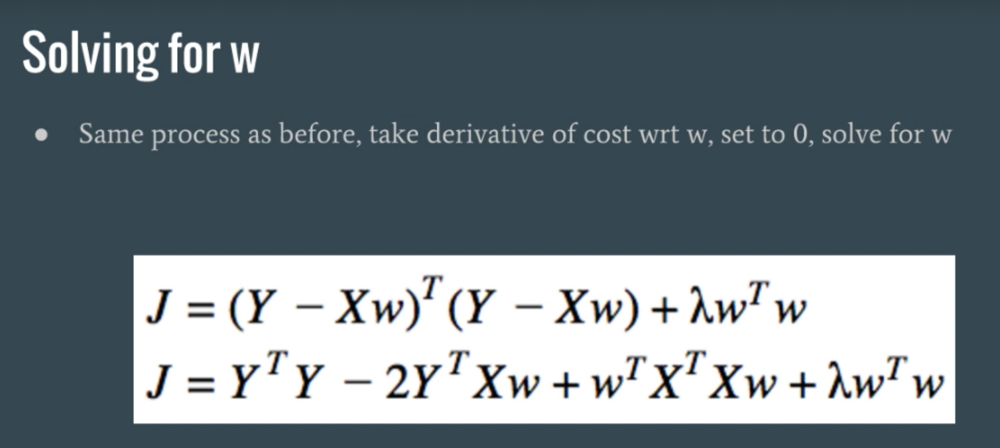

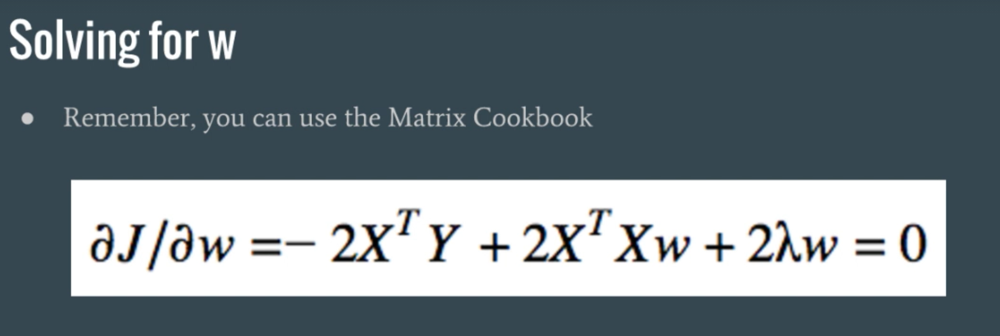

## <a href='https://www.math.uwaterloo.ca/~hwolkowi/matrixcookbook.pdf'> Matric Cookbook</a>

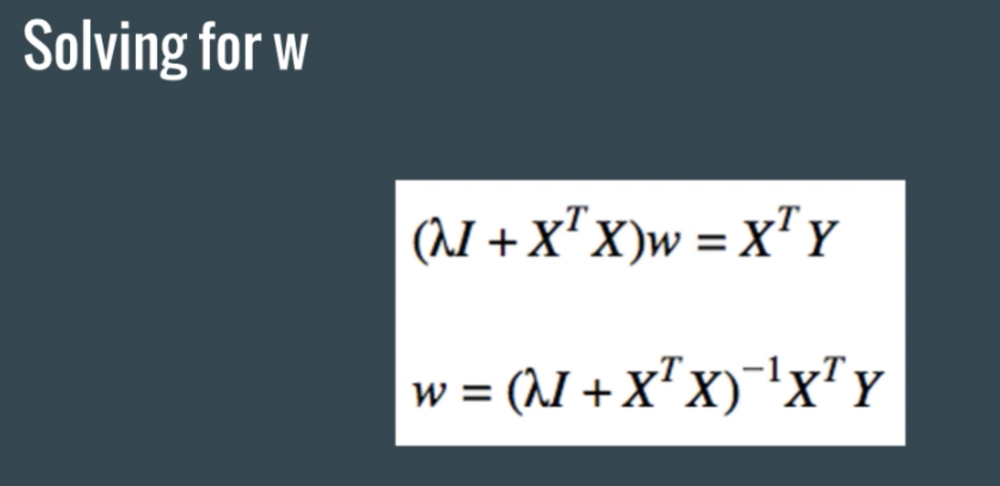

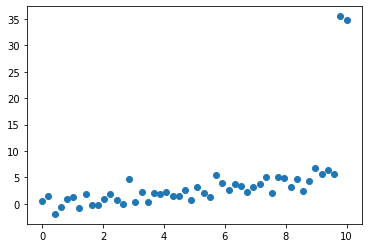

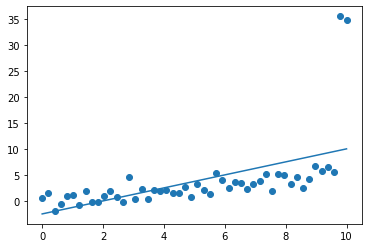

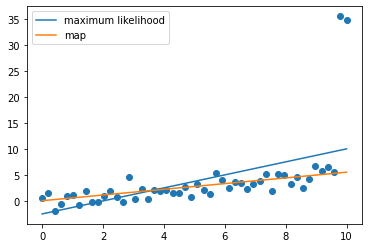

In [24]:

from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future



import numpy as np
import matplotlib.pyplot as plt

N = 50

# generate the data
X = np.linspace(0,10,N)
Y = 0.5*X + np.random.randn(N)

# make outliers
Y[-1] += 30
Y[-2] += 30

# plot the data
plt.scatter(X, Y)
plt.show()

# add bias term
X = np.vstack([np.ones(N), X]).T

# plot the maximum likelihood solution
w_ml = np.linalg.solve(X.T.dot(X), X.T.dot(Y))
Yhat_ml = X.dot(w_ml)
plt.scatter(X[:,1], Y)
plt.plot(X[:,1], Yhat_ml)
plt.show()

# plot the regularized solution
# probably don't need an L2 regularization this high in many problems
# everything in this example is exaggerated for visualization purposes
l2 = 1000.0
w_map = np.linalg.solve(l2*np.eye(2) + X.T.dot(X), X.T.dot(Y))
Yhat_map = X.dot(w_map)
plt.scatter(X[:,1], Y)
plt.plot(X[:,1], Yhat_ml, label='maximum likelihood')
plt.plot(X[:,1], Yhat_map, label='map')
plt.legend()
plt.show()

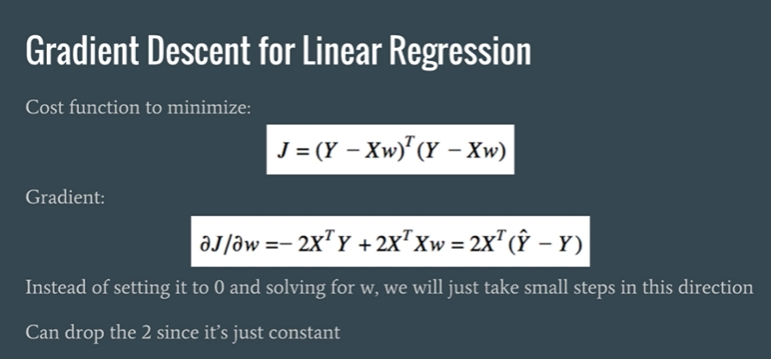

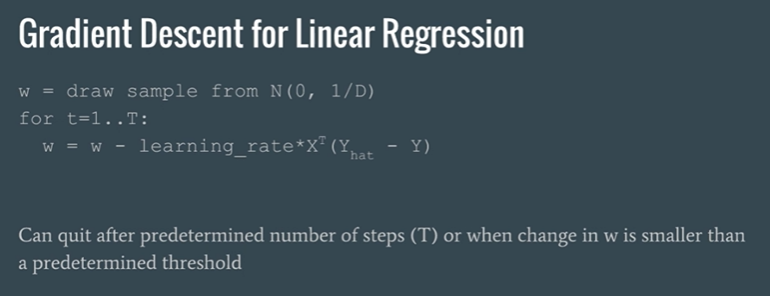

X: [[1. 1. 0.]
 [1. 1. 0.]
 [1. 1. 0.]
 [1. 1. 0.]
 [1. 1. 0.]
 [1. 0. 1.]
 [1. 0. 1.]
 [1. 0. 1.]
 [1. 0. 1.]
 [1. 0. 1.]]


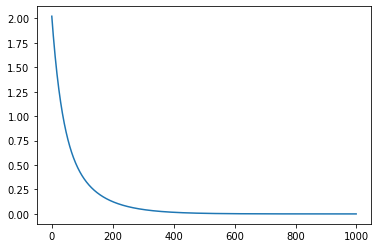

final w: [ 0.15484756 -0.14849973  0.83880402]


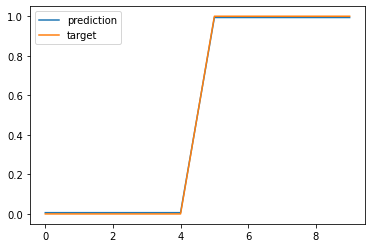

In [25]:

from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future


import numpy as np
import matplotlib.pyplot as plt

N = 10
D = 3
X = np.zeros((N, D))
X[:,0] = 1 # bias term
X[:5,1] = 1
X[5:,2] = 1
Y = np.array([0]*5 + [1]*5)

# print X so you know what it looks like
print("X:", X)

# won't work!
# w = np.linalg.solve(X.T.dot(X), X.T.dot(Y))

# let's try gradient descent
costs = [] # keep track of squared error cost
w = np.random.randn(D) / np.sqrt(D) # randomly initialize w
learning_rate = 0.001
for t in range(1000):
  # update w
  Yhat = X.dot(w)
  delta = Yhat - Y
  w = w - learning_rate*X.T.dot(delta)

  # find and store the cost
  mse = delta.dot(delta) / N
  costs.append(mse)

# plot the costs
plt.plot(costs)
plt.show()

print("final w:", w)

# plot prediction vs target
plt.plot(Yhat, label='prediction')
plt.plot(Y, label='target')
plt.legend()
plt.show()

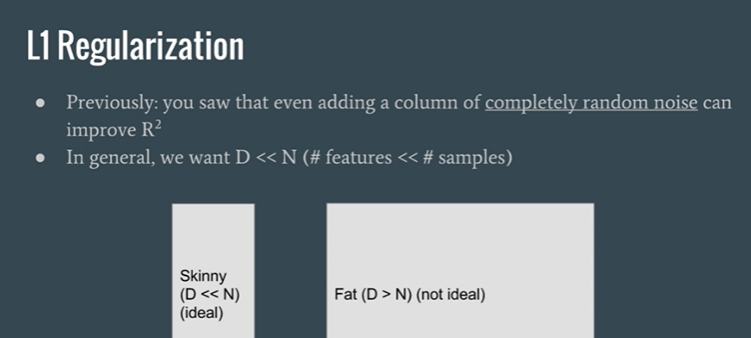

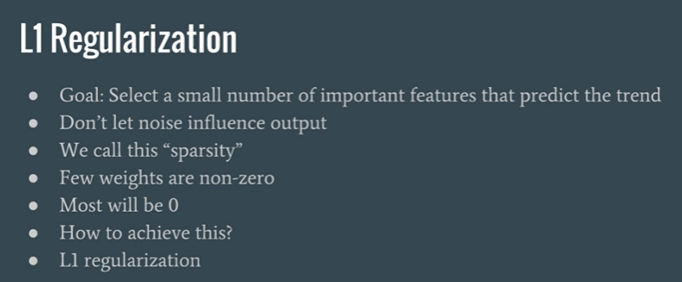

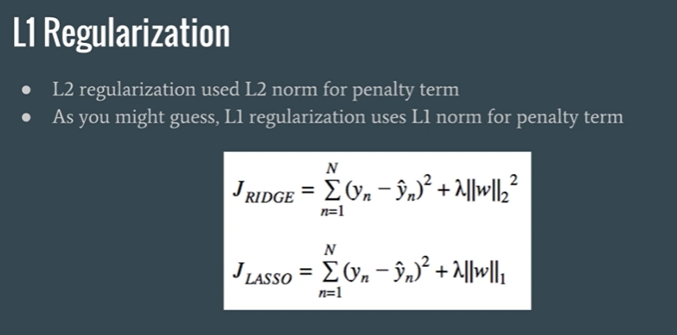

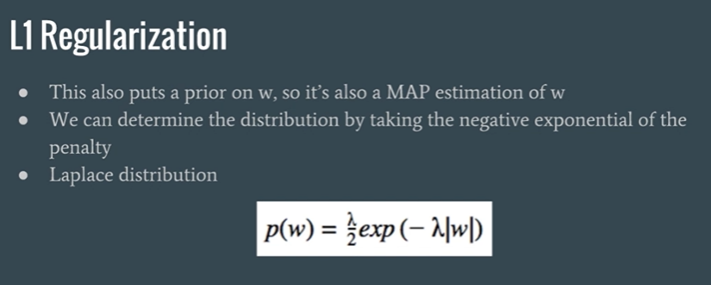

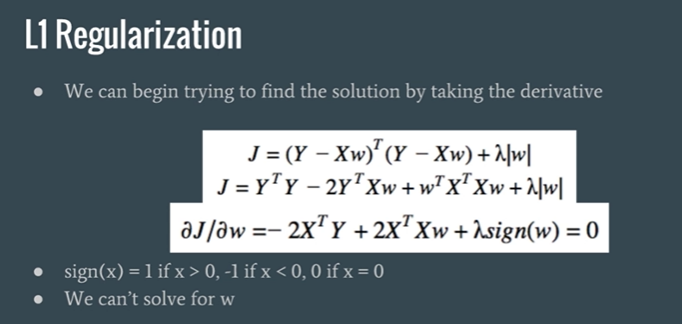

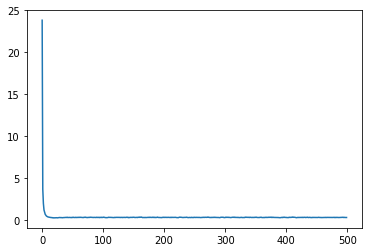

final w: [ 9.51348407e-01  4.67159888e-01 -4.54008002e-01  1.87012986e-02
  9.51009115e-03  6.86109594e-03 -1.64342992e-02  1.80139401e-03
 -2.51177153e-03  2.29396654e-02 -4.31754045e-02  2.49967943e-03
 -1.19147443e-02 -1.85960040e-02  1.05417691e-02 -1.24630982e-02
  1.49786635e-02 -1.79974953e-02  1.51152771e-02 -1.82287537e-02
 -1.74744742e-02 -9.93386253e-03 -1.98597866e-02 -4.74158469e-03
 -4.10579137e-03 -1.19361710e-02 -1.99536729e-02 -1.84868647e-03
 -8.59049119e-03 -2.43144733e-04 -3.59108210e-03  6.79197205e-03
  1.48778044e-02  3.72198585e-03 -2.26448963e-02 -8.96036743e-03
  7.21215893e-03  1.70454486e-02 -8.71913865e-03 -2.42615949e-03
 -2.16657248e-02  4.96634139e-03  8.88439627e-03  9.54239932e-03
 -5.50175705e-03 -7.04650423e-03 -6.82400997e-04 -1.71031159e-02
 -2.76256680e-02  1.01177147e-02]


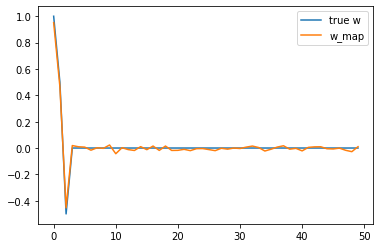

In [26]:

from __future__ import print_function, division
from builtins import range
# Note: you may need to update your version of future
# sudo pip install -U future


import numpy as np
import matplotlib.pyplot as plt

N = 50
D = 50

# uniformly distributed numbers between -5, +5
X = (np.random.random((N, D)) - 0.5)*10

# true weights - only the first 3 dimensions of X affect Y
true_w = np.array([1, 0.5, -0.5] + [0]*(D - 3))

# generate Y - add noise
Y = X.dot(true_w) + np.random.randn(N)*0.5

# perform gradient descent to find w
costs = [] # keep track of squared error cost
w = np.random.randn(D) / np.sqrt(D) # randomly initialize w
learning_rate = 0.001
l1 = 10.0 # Also try 5.0, 2.0, 1.0, 0.1 - what effect does it have on w?
for t in range(500):
  # update w
  Yhat = X.dot(w)
  delta = Yhat - Y
  w = w - learning_rate*(X.T.dot(delta) + l1*np.sign(w))

  # find and store the cost
  mse = delta.dot(delta) / N
  costs.append(mse)

# plot the costs
plt.plot(costs)
plt.show()

print("final w:", w)

# plot our w vs true w
plt.plot(true_w, label='true w')
plt.plot(w, label='w_map')
plt.legend()
plt.show()

In [ ]:
# Yhat